## Devices Life Prediction Version 0.2
#### Developed by A.Okada, T.Shirakami, K.Kuramitsu, K.Iino and N.Yamazaki
#### Copyright© A.Okada, T.Shirakami, K.Kuramitsu, K.Iino and N.Yamazaki, 2021
#### Start from June 8, 2021

#### https://github.com/AISTARWORKS/CONVENTION.git

### Sample Generator

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24003 entries, 0 to 24002
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   sample_id                     24000 non-null  float64
 1   defect                        24000 non-null  float64
 2   time                          24000 non-null  float64
 3   rpm                           24000 non-null  float64
 4   temp                          24000 non-null  float64
 5   power                         24000 non-null  float64
 6   cum_rpm                       24000 non-null  float64
 7   cum_temp                      24000 non-null  float64
 8   cum_power                     24000 non-null  float64
 9   RpmSpec                       24000 non-null  float64
 10  PowerSpec                     24000 non-null  float64
 11  DiameterSpec                  24000 non-null  float64
 12  ThicknessSpec                 24000 non-null  float64
 13  Q

Text(0, 0.5, 'cumurated_life_impact_factor')

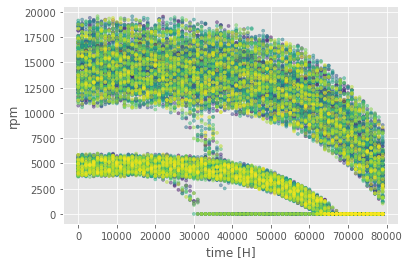

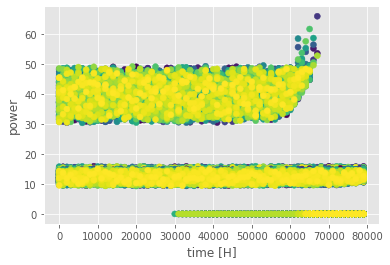

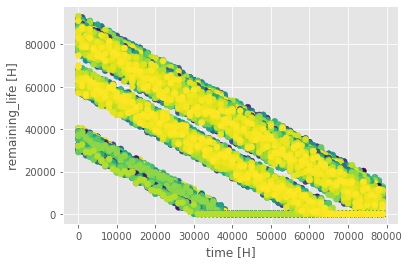

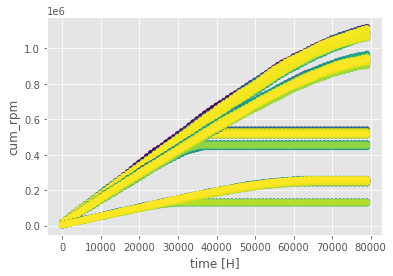

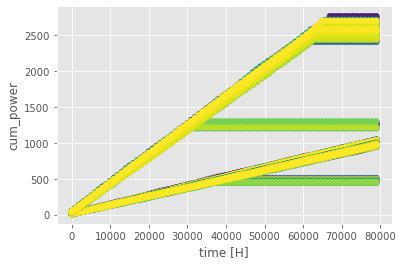

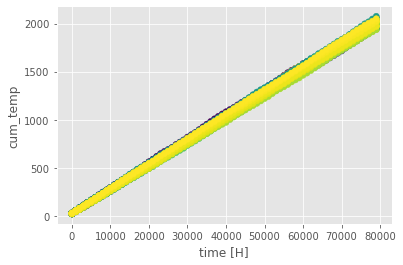

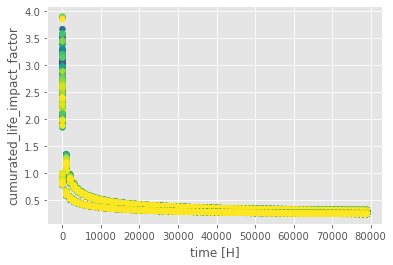

In [46]:
# Library import
import pandas as pd # 表=DataFrameに関する
import numpy as np # 行列に関する
import random # ramdom値生成
import math # 数学演算、logとかsin, cosとか
import matplotlib.pyplot as plt # グラフに関する
import matplotlib as mpl # 同じくグラフ関係、要らないかも。

# DataFrameの値の小数点以下桁数はここで調整。
pd.options.display.precision = 2

Sampling = 1000
NumSample = 100

# 複数FANタイプに対応するため関数化。
def sample_generator(RpmSpec,
                     PowerSpec,
                     TempSpec,
                     DiameterSpec,
                     ThicknessSpec,
                     QSpec,
                     PSpec,
                     LifeSpec,
                     Sampling,
                     NumSample):

    data_list = [[]] # sampling毎のlistなので2次元list
#     cum_rpm = 0
#     cum_temp = 0
#     cum_power = 0

    for sample_id in range(NumSample):

        rpm = RpmSpec # 初期値。最初から0だと困る。
        cum_rpm = 0
        cum_temp = 0
        cum_power = 0
        cumurated_life_impact_factor = 0

        if np.random.random() < 0.1: # ランダムに10%は寿命の短い不良品が混入  ==>rpmが下がりpowerが増える
            defect = 1
        else:
            defect = 0

        for time in range(0, LifeSpec*2, Sampling):

            temp = 25 + random.uniform(-5,5)

            if rpm <= 0: # 前のforループで死んでたら後は永久に死。
                power = 0
                death = 1
            else:

                if defect == 1: # 不良品の場合
                    # rpm; 40degCでフル回転, 時間とともに低下、 +/-5% 誤差考慮でランダム
                    rpm = (-1 * ((time + Sampling)/8000) ** 6 + RpmSpec * temp / TempSpec) * (1-random.uniform(-0.05,0.05))
                    if rpm < 0.1*RpmSpec:
                        rpm = 0
                        power = 0
                        death = 1
                        remaining_life = 0
                    else:   
                        #power: rpmの低下により増加する成分と、温度に追従する成分をもつ。+/-5%誤差考慮でランダム 
                        power = (0.5 * (4000/rpm) ** 1.2 + PowerSpec * (temp / TempSpec)) * (1 - random.uniform(-0.05,0.05))
                        death = 0
                        # remaining_lifeは逆算
                        remaining_life = ((RpmSpec*temp/TempSpec - 0.1*RpmSpec)**(1/6)) * 8000 * (1 - random.uniform(-0.05,0.05)) - time
                        if remaining_life < 0:
                            remaining_life = 0
                else: # 良品の場合
                    rpm = (-1 * ((time + Sampling)/8000) ** 4 + RpmSpec * temp / TempSpec) * (1-random.uniform(-0.05,0.05))
                    if rpm < 100:
                        rpm = 0
                        power = 0
                        death = 1
                        remaining_life = 0
                    else: 
                        power = (0.5 * (4000/rpm) ** 1.1 + PowerSpec * (temp / TempSpec)) * (1 - random.uniform(-0.05,0.05))
                        death = 0
                        remaining_life = ((RpmSpec*temp/TempSpec - 0.1*RpmSpec)**(1/4)) * 8000 * (1 - random.uniform(-0.05,0.05)) -time
                        if remaining_life < 0:
                            remaining_life = 0

            # 累積。cum = cumurated = 累積
            cum_rpm += rpm
            cum_temp += temp
            cum_power += power

            # FANの寿命に与えるファクタとして、累積rpmの逆数, 累積temp, 累積powerの積の対数
            # cumurated_life_impact_factorは、0を中心に+/-1以内で推移。大きいと寿命に与える影響大。

            cumurated_life_impact_factor = math.log(10, ((1/cum_rpm) ** 0.5) * cum_temp * cum_power)

            data_list.append([sample_id,
                            defect,
                            time, 
                            rpm, 
                            temp, 
                            power, 
                            cum_rpm, 
                            cum_temp, 
                            cum_power, 
                            RpmSpec, 
                            PowerSpec, 
                            DiameterSpec, 
                            ThicknessSpec, 
                            QSpec, 
                            PSpec, 
                            LifeSpec, 
                            cumurated_life_impact_factor, 
                            death,
                            remaining_life])
    return data_list

fan40 = sample_generator(RpmSpec = 25000,
                        PowerSpec = 20.16,
                        TempSpec = 40,
                        DiameterSpec = 40,
                        ThicknessSpec = 28,
                        QSpec = 0.83, # m^3/min
                        PSpec = 1100, # Pa
                        LifeSpec = 40000,
                        Sampling = Sampling,
                        NumSample = NumSample)

fan40cr = sample_generator(RpmSpec = 22000,
                        PowerSpec = 19.2,
                        TempSpec = 40,
                        DiameterSpec = 40,
                        ThicknessSpec = 56,
                        QSpec = 0.9, # m^3/min
                        PSpec = 1045, # Pa
                        LifeSpec = 40000,
                        Sampling = Sampling,
                        NumSample = NumSample)

fan120 = sample_generator(RpmSpec = 7650,
                        PowerSpec = 1.3 * 48,
                        TempSpec = 40,
                        DiameterSpec = 120,
                        ThicknessSpec = 38,
                        QSpec = 7.49, # m^3/min
                        PSpec = 532.5, # Pa,
                        LifeSpec = 40000,
                        Sampling = Sampling,
                        NumSample = NumSample)
# 各fan統合
list = fan40
for data in fan40cr:
    list.append(data)

for data in fan120:
    list.append(data)

df = pd.DataFrame(list,    # listは3種ファン統合。別々にやる場合は、fan40, fan40cr or fan120
                 columns=['sample_id',
                          'defect',
                          'time', 
                          'rpm', 
                          'temp', 
                          'power', 
                          'cum_rpm', 
                          'cum_temp', 
                          'cum_power', 
                          'RpmSpec', 
                          'PowerSpec', 
                          'DiameterSpec', 
                          'ThicknessSpec', 
                          'QSpec', 
                          'PSpec', 
                          'LifeSpec',
                          'cumurated_life_impact_factor', 
                          'death',
                          'remaining_life'])

# df.to_csv("./sample_data_check3.csv")

print('df= ', df.info())

fig, ax = plt.subplots()
ax.scatter(df['time'], df['rpm'], c=df['sample_id'], s=10, alpha=0.5)
plt.xlabel('time [H]',size=12)
plt.ylabel('rpm',size=12)

fig, ax = plt.subplots()
ax.scatter(df['time'], df['power'], c=df['sample_id'])
plt.xlabel('time [H]',size=12)
plt.ylabel('power',size=12)

fig, ax = plt.subplots()
ax.scatter(df['time'], df['remaining_life'], c=df['sample_id'])
plt.xlabel('time [H]',size=12)
plt.ylabel('remaining_life [H]',size=12)

fig, ax = plt.subplots()
ax.scatter(df['time'], df['cum_rpm'], c=df['sample_id'])
plt.xlabel('time [H]',size=12)
plt.ylabel('cum_rpm',size=12)

fig, ax = plt.subplots()
ax.scatter(df['time'], df['cum_power'], c=df['sample_id'])
plt.xlabel('time [H]',size=12)
plt.ylabel('cum_power',size=12)

fig, ax = plt.subplots()
ax.scatter(df['time'], df['cum_temp'], c=df['sample_id'])
plt.xlabel('time [H]',size=12)
plt.ylabel('cum_temp',size=12)

fig, ax = plt.subplots()
ax.scatter(df['time'], df['cumurated_life_impact_factor'], c=df['sample_id'])
plt.xlabel('time [H]',size=12)
plt.ylabel('cumurated_life_impact_factor',size=12)

In [47]:
df = df.dropna(how="any")

indexNames = df[ df['death'] == 1 ].index
df.drop(indexNames , inplace=True)

indexNames = df[ df['remaining_life'] == 0 ].index
df.drop(indexNames , inplace=True)

df.to_csv('./sample_data.csv')
df

,sample_id,defect,time,rpm,temp,power,cum_rpm,cum_temp,cum_power,RpmSpec,PowerSpec,DiameterSpec,ThicknessSpec,QSpec,PSpec,LifeSpec,cumurated_life_impact_factor,death,remaining_life
1,0.0,0.0,0.0,17410.26,27.97,14.02,17410.26,27.97,14.02,25000.0,20.16,40.0,28.0,0.83,1100.0,40000.0,2.11,0.0,89064.92
2,0.0,0.0,1000.0,18778.65,28.91,14.65,36188.91,56.88,28.67,25000.0,20.16,40.0,28.0,0.83,1100.0,40000.0,1.07,0.0,85640.86
3,0.0,0.0,2000.0,15205.12,24.91,12.39,51394.03,81.79,41.06,25000.0,20.16,40.0,28.0,0.83,1100.0,40000.0,0.85,0.0,83896.49
4,0.0,0.0,3000.0,17223.55,27.18,13.78,68617.58,108.97,54.84,25000.0,20.16,40.0,28.0,0.83,1100.0,40000.0,0.74,0.0,85388.91
5,0.0,0.0,4000.0,15335.57,25.10,12.68,83953.15,134.07,67.52,25000.0,20.16,40.0,28.0,0.83,1100.0,40000.0,0.67,0.0,78831.27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23983,99.0,0.0,60000.0,1289.85,24.41,40.71,256001.02,1562.03,2476.46,7650.0,62.40,120.0,38.0,7.49,532.5,40000.0,0.26,0.0,6183.61
23984,99.0,0.0,61000.0,868.44,23.31,38.21,256869.45,1585.34,2514.67,7650.0,62.40,120.0,38.0,7.49,532.5,40000.0,0.26,0.0,934.28
23985,99.0,0.0,62000.0,1701.33,29.22,45.48,258570.78,1614.56,2560.14,7650.0,62.40,120.0,38.0,7.49,532.5,40000.0,0.26,0.0,1426.65
23986,99.0,0.0,63000.0,1360.59,28.38,47.37,259931.37,1642.94,2607.51,7650.0,62.40,120.0,38.0,7.49,532.5,40000.0,0.25,0.0,4903.14


### Prediction

In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
plt.style.use('ggplot')
import seaborn as sns

df = pd.read_csv('sample_data.csv', index_col=[0])
df = df.dropna(how="any")

# print(df.head(), df.tail())
df.info()
# print(df.describe())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21013 entries, 1 to 23987
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   sample_id                     21013 non-null  float64
 1   defect                        21013 non-null  float64
 2   time                          21013 non-null  float64
 3   rpm                           21013 non-null  float64
 4   temp                          21013 non-null  float64
 5   power                         21013 non-null  float64
 6   cum_rpm                       21013 non-null  float64
 7   cum_temp                      21013 non-null  float64
 8   cum_power                     21013 non-null  float64
 9   RpmSpec                       21013 non-null  float64
 10  PowerSpec                     21013 non-null  float64
 11  DiameterSpec                  21013 non-null  float64
 12  ThicknessSpec                 21013 non-null  float64
 13  Q

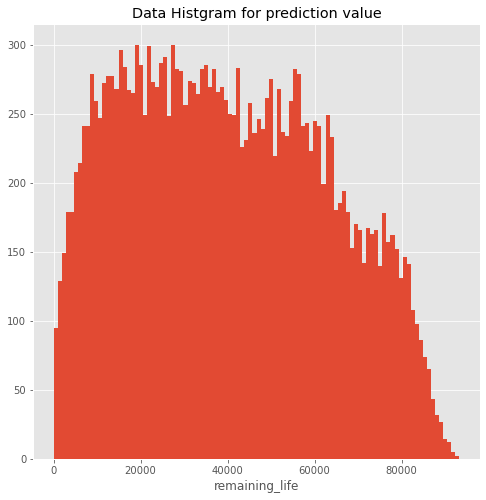

In [49]:
plt.figure(figsize=(8, 8))
plt.hist(df['remaining_life'], bins=100)
plt.title('Data Histgram for prediction value')
plt.xlabel('remaining_life',size=12)
plt.show()

In [50]:
from sklearn.model_selection import train_test_split
import xgboost as xgb

# 機械学習では、学習させる特徴量をX, 求める答えをyで表す。
X = df.drop(columns=['remaining_life', 'sample_id', 'defect'])
y = df['remaining_life']

print(X.shape)
print(y.shape)

# trainとは学習に用いるデータ、testとは検証用に取っておくまだ見ぬデータ。
# 自動的に検証用のまだ見ぬデータを20%とっておく。
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,
                                                    random_state=0)
print(X_train.shape)
print(X_test.shape)


(21013, 16)
(21013,)
(16810, 16)
(4203, 16)


In [51]:

params = {
    'silent': 1,
    'max_depth': 6,
    'min_child_weight': 1,
    'eta': 0.1,
    'tree_method': 'exact',
    'objective': 'reg:linear',
    'eval_metric': 'rmse',
    'predictor': 'cpu_predictor'
}

# GPUの場合
# params = {
#     'silent': 1,
#     'max_depth': 6,
#     'min_child_weight': 1,
#     'eta': 0.1,
#     'tree_method': 'gpu_exact',
#     'objective': 'gpu:reg:linear',
#     'eval_metric': 'rmse',
#     'predictor': 'gpu_predictor'
# }

dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)
model = xgb.train(params=params,
                  dtrain=dtrain,
                  num_boost_round=1000,
                  early_stopping_rounds=5,
                  evals=[(dtest, 'test')])


[13:54:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
[13:54:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[0]	test-rmse:41675.12891
[1]	test-rmse:37710.74609
[2]	test-rmse:34168.38672
[3]	test-rmse:30998.58398
[4]	test-rmse:28162.45508
[5]	test-rmse:25642.77148
[6]	test-rmse:23400.55664
[7]	test-rmse:21405.63867
[8]	test-rmse:19637.21289
[9]	test-rmse:18082.83789
[10]	test-rmse:16728.32227
[11]	test-rmse:15534.92871
[12]	test-rmse:14499.01465
[13]	test-rmse:13599.26269
[14]	test-rmse:12818.42481
[15]	test-rmse:12147.15527
[16]	test-rmse:

[13:54:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
C:\Users\nnroc\anaconda3\lib\site-packages\xgboost\core.py:101: UserWarning: ntree_limit is deprecated, use `iteration_range` or model slicing instead.
  warnings.warn(


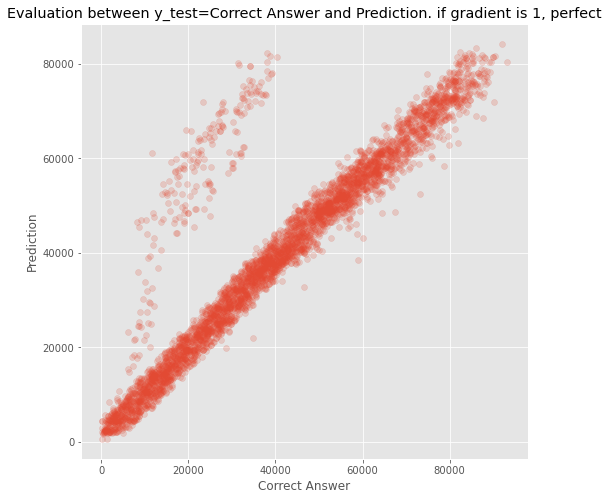

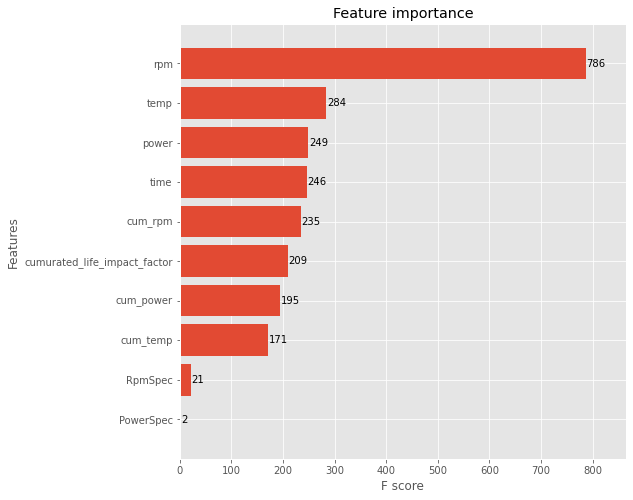

In [52]:
print(model)
model.save_model('./xgb1.model')

model.load_model('./xgb1.model')

prediction = model.predict(xgb.DMatrix(X_test), 
                           ntree_limit=model.best_ntree_limit)

plt.figure(figsize=(8, 8))
# plt.scatter(y_test[:1000], prediction[:1000], alpha=0.2)
plt.scatter(y_test, prediction, alpha=0.2)
plt.title('Evaluation between y_test=Correct Answer and Prediction. if gradient is 1, perfect')
plt.xlabel('Correct Answer',size=12)
plt.ylabel('Prediction',size=12)
plt.show()

fig, ax = plt.subplots(figsize=(8, 8))
xgb.plot_importance(model, max_num_features=12, height=0.8, ax=ax)
plt.show()

      index  remaining_life
0     17476        28735.17
1     10472        14674.89
2      5432        14468.33
3     10589        60730.25
4     12430        61509.05
...     ...             ...
4198   3483        39480.59
4199  11688        78031.53
4200   9299        60416.46
4201  16918        24432.72
4202  23874        32035.80

[4203 rows x 2 columns]
[28735.171580606737, 14674.893112134436, 14468.334067370844, 60730.25308432672, 61509.05021941231] 4203
[29260.8828125, 17063.52734375, 14457.8154296875, 53666.3203125, 58692.90625] 4203
[-0.018295044121054205, -0.16277012809316072, 0.000727010976824635, 0.11631653769033583, 0.04578422133599347]
      defference_rate
0           -1.83e-02
1           -1.63e-01
2            7.27e-04
3            1.16e-01
4            4.58e-02
...               ...
4198         4.26e-02
4199         1.05e-01
4200         4.05e-03
4201        -5.11e-02
4202         5.05e-02

[4203 rows x 1 columns]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42

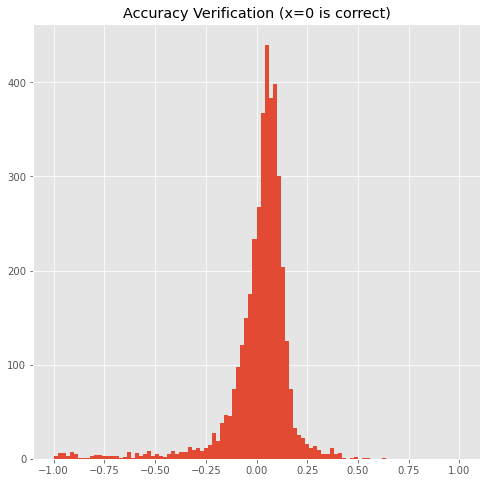

In [53]:
X_test_df = pd.DataFrame(X_test)
y_test_df = pd.DataFrame(y_test)
prediction_df = pd.DataFrame(prediction, columns=['remaining_life_pred']) 

X_test_df_reset = X_test_df.reset_index()
y_test_df_reset = y_test_df.reset_index()
prediction_df_reset = prediction_df.reset_index()

print(y_test_df_reset)

y_test_list = y_test_df_reset['remaining_life'].to_list()
prediction_list = prediction_df_reset['remaining_life_pred'].to_list()

print(y_test_list[:5], len(y_test_list))
print(prediction_list[:5], len(prediction_list))
difference_list = []

for i in range(len(y_test_list)):
    diff = (y_test_list[i] - prediction_list[i]) / y_test_list[i]
    difference_list.append(diff)

print(difference_list[:5])

difference_df = pd.DataFrame(difference_list, columns=['defference_rate'])
print(difference_df)
print('')
print('difference_df.info()==>', difference_df.info())
print('difference_df.describe()==>', difference_df.describe())
print('length comparison==>', len(X_test_df_reset), len(y_test_df_reset), len(prediction_df_reset), len(difference_df))

difference_df_reset = difference_df.reset_index()

plt.figure(figsize=(8, 8))
plt.hist(difference_df['defference_rate'], bins=100, range=(-1,1))
plt.title('Accuracy Verification (x=0 is correct)')
plt.show()

report_df = pd.concat([X_test_df_reset, y_test_df_reset, prediction_df_reset, difference_df_reset], axis=1)

report_df

report_df.to_csv("./report_remaining_life.csv")


#### Can Defects be detected?

In [54]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
plt.style.use('ggplot')
import seaborn as sns

df = pd.read_csv('sample_data.csv', index_col=[0])
df = df.dropna(how="any")

# print(df.head(), df.tail())
df.info()
# print(df.describe())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21013 entries, 1 to 23987
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   sample_id                     21013 non-null  float64
 1   defect                        21013 non-null  float64
 2   time                          21013 non-null  float64
 3   rpm                           21013 non-null  float64
 4   temp                          21013 non-null  float64
 5   power                         21013 non-null  float64
 6   cum_rpm                       21013 non-null  float64
 7   cum_temp                      21013 non-null  float64
 8   cum_power                     21013 non-null  float64
 9   RpmSpec                       21013 non-null  float64
 10  PowerSpec                     21013 non-null  float64
 11  DiameterSpec                  21013 non-null  float64
 12  ThicknessSpec                 21013 non-null  float64
 13  Q

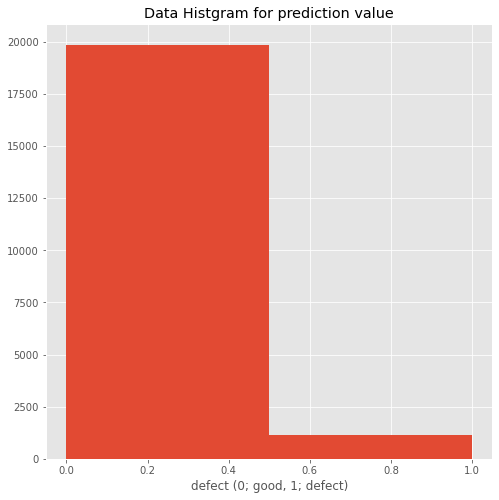

In [55]:
plt.figure(figsize=(8, 8))
plt.hist(df['defect'], bins=2)
plt.title('Data Histgram for prediction value')
plt.xlabel('defect (0; good, 1; defect)',size=12)
plt.show()

In [56]:
from sklearn.model_selection import train_test_split
import xgboost as xgb

X = df.drop(columns=['remaining_life', 'sample_id', 'defect'])
y = df['defect']

print(X.shape)
print(y.shape)

# trainとは学習に用いるデータ、testとは検証用に取っておくまだ見ぬデータ。
# 自動的に検証用のまだ見ぬデータを20%とっておく。
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,
                                                    random_state=0)
print(X_train.shape)
print(X_test.shape)


(21013, 16)
(21013,)
(16810, 16)
(4203, 16)


In [57]:
params = {
    'silent': 1,
    'max_depth': 6,
    'min_child_weight': 1,
    'eta': 0.1,
    'tree_method': 'exact',
    'objective': 'reg:linear',
    'eval_metric': 'rmse',
    'predictor': 'cpu_predictor'
}

# GPUの場合
# params = {
#     'silent': 1,
#     'max_depth': 6,
#     'min_child_weight': 1,
#     'eta': 0.1,
#     'tree_method': 'gpu_exact',
#     'objective': 'gpu:reg:linear',
#     'eval_metric': 'rmse',
#     'predictor': 'gpu_predictor'
# }

dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)
model = xgb.train(params=params,
                  dtrain=dtrain,
                  num_boost_round=1000,
                  early_stopping_rounds=5,
                  evals=[(dtest, 'test')])

[13:54:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
[13:54:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[0]	test-rmse:0.45892
[1]	test-rmse:0.42369
[2]	test-rmse:0.39224
[3]	test-rmse:0.36411
[4]	test-rmse:0.33973
[5]	test-rmse:0.31878
[6]	test-rmse:0.30046
[7]	test-rmse:0.28480
[8]	test-rmse:0.27140
[9]	test-rmse:0.26005
[10]	test-rmse:0.25038
[11]	test-rmse:0.24235
[12]	test-rmse:0.23456
[13]	test-rmse:0.22829
[14]	test-rmse:0.22354
[15]	test-rmse:0.21924
[16]	test-rmse:0.21569
[17]	test-rmse:0.21262
[18]	test-rmse:0.21010
[19]	test-

[13:54:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
C:\Users\nnroc\anaconda3\lib\site-packages\xgboost\core.py:101: UserWarning: ntree_limit is deprecated, use `iteration_range` or model slicing instead.
  warnings.warn(


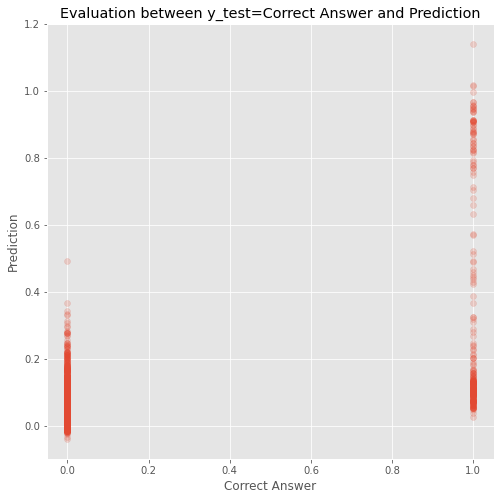

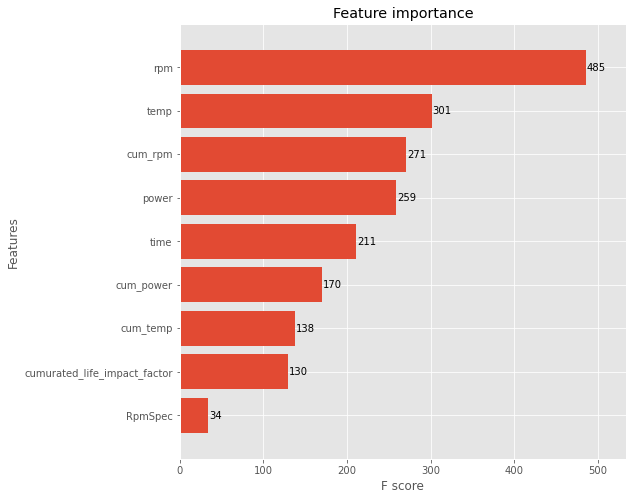

In [58]:
print(model)
model.save_model('./xgb1.model')

model.load_model('./xgb1.model')

prediction = model.predict(xgb.DMatrix(X_test), 
                           ntree_limit=model.best_ntree_limit)

plt.figure(figsize=(8, 8))
# plt.scatter(y_test[:1000], prediction[:1000], alpha=0.2)
plt.scatter(y_test, prediction, alpha=0.2)
plt.title('Evaluation between y_test=Correct Answer and Prediction')
plt.xlabel('Correct Answer',size=12)
plt.ylabel('Prediction',size=12)
plt.show()

fig, ax = plt.subplots(figsize=(8, 8))
xgb.plot_importance(model, max_num_features=12, height=0.8, ax=ax)
plt.show()

      index  defect
0     17476     0.0
1     10472     0.0
2      5432     0.0
3     10589     0.0
4     12430     0.0
...     ...     ...
4198   3483     0.0
4199  11688     0.0
4200   9299     0.0
4201  16918     0.0
4202  23874     0.0

[4203 rows x 2 columns]
[0.0, 0.0, 0.0, 0.0, 0.0] 4203
[0.002469060942530632, 0.0034600510261952877, 0.0019223339622840285, 0.07091264426708221, 0.05826512351632118] 4203
[-0.002469060942530632, -0.0034600510261952877, -0.0019223339622840285, -0.07091264426708221, -0.05826512351632118]
      defference_rate
0           -2.47e-03
1           -3.46e-03
2           -1.92e-03
3           -7.09e-02
4           -5.83e-02
...               ...
4198        -3.64e-02
4199        -1.03e-01
4200        -5.77e-02
4201        -2.12e-04
4202        -1.26e-04

[4203 rows x 1 columns]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4203 entries, 0 to 4202
Data columns (total 1 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------

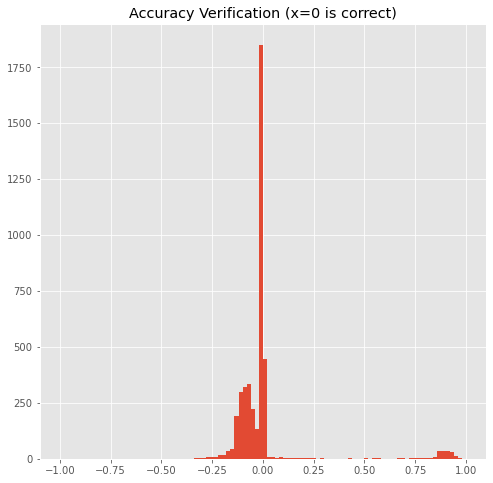

In [59]:
X_test_df = pd.DataFrame(X_test)
y_test_df = pd.DataFrame(y_test)
prediction_df = pd.DataFrame(prediction, columns=['defect_pred']) 

X_test_df_reset = X_test_df.reset_index()
y_test_df_reset = y_test_df.reset_index()
prediction_df_reset = prediction_df.reset_index()

print(y_test_df_reset)

y_test_list = y_test_df_reset['defect'].to_list()
prediction_list = prediction_df_reset['defect_pred'].to_list()

print(y_test_list[:5], len(y_test_list))
print(prediction_list[:5], len(prediction_list))
difference_list = []

for i in range(len(y_test_list)):
    diff = (y_test_list[i] - prediction_list[i])
    difference_list.append(diff)

print(difference_list[:5])

difference_df = pd.DataFrame(difference_list, columns=['defference_rate'])
print(difference_df)
print('')
print('difference_df.info()==>', difference_df.info())
print('difference_df.describe()==>', difference_df.describe())
print('length comparison==>', len(X_test_df_reset), len(y_test_df_reset), len(prediction_df_reset), len(difference_df))

difference_df_reset = difference_df.reset_index()

plt.figure(figsize=(8, 8))
plt.hist(difference_df['defference_rate'], bins=100, range=(-1,1))
plt.title('Accuracy Verification (x=0 is correct)')
plt.show()

report_df = pd.concat([X_test_df_reset, y_test_df_reset, prediction_df_reset, difference_df_reset], axis=1)

report_df

report_df.to_csv("./report_detect_defect.csv")

In [60]:
print('Completed!!Completed!!!Completed!!!!Completed!!!!Completed!!!!Completed!!!!Completed!!!')

Completed!!Completed!!!Completed!!!!Completed!!!!Completed!!!!Completed!!!!Completed!!!
